In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/ibm-hr-analytics-attrition-dataset/WA_Fn-UseC_-HR-Employee-Attrition.csv


# STEP 1: Importing the libraries

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix, classification_report , accuracy_score
from sklearn.model_selection import train_test_split

import warnings
warnings.filterwarnings("ignore")

# STEP 2: Reading the data

In [3]:
df= pd.read_csv("/kaggle/input/ibm-hr-analytics-attrition-dataset/WA_Fn-UseC_-HR-Employee-Attrition.csv")

# STEP 3: Data Understanding

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

In [5]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


In [6]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,1470.0,36.923810,9.135373,18.0,30.00,36.0,43.00,60.0
DailyRate,1470.0,802.485714,403.509100,102.0,465.00,802.0,1157.00,1499.0
DistanceFromHome,1470.0,9.192517,8.106864,1.0,2.00,7.0,14.00,29.0
Education,1470.0,2.912925,1.024165,1.0,2.00,3.0,4.00,5.0
EmployeeCount,1470.0,1.000000,0.000000,1.0,1.00,1.0,1.00,1.0
EmployeeNumber,1470.0,1024.865306,602.024335,1.0,491.25,1020.5,1555.75,2068.0
EnvironmentSatisfaction,1470.0,2.721769,1.093082,1.0,2.00,3.0,4.00,4.0
HourlyRate,1470.0,65.891156,20.329428,30.0,48.00,66.0,83.75,100.0
JobInvolvement,1470.0,2.729932,0.711561,1.0,2.00,3.0,3.00,4.0
JobLevel,1470.0,2.063946,1.106940,1.0,1.00,2.0,3.00,5.0


In [7]:
df.shape

(1470, 35)

In [8]:
df.describe(include='object')


,Attrition,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,Over18,OverTime
count,1470,1470,1470,1470,1470,1470,1470,1470,1470
unique,2,3,3,6,2,9,3,1,2
top,No,Travel_Rarely,Research & Development,Life Sciences,Male,Sales Executive,Married,Y,No
freq,1233,1043,961,606,882,326,673,1470,1054


In [9]:
df.columns.tolist()

['Age',
 'Attrition',
 'BusinessTravel',
 'DailyRate',
 'Department',
 'DistanceFromHome',
 'Education',
 'EducationField',
 'EmployeeCount',
 'EmployeeNumber',
 'EnvironmentSatisfaction',
 'Gender',
 'HourlyRate',
 'JobInvolvement',
 'JobLevel',
 'JobRole',
 'JobSatisfaction',
 'MaritalStatus',
 'MonthlyIncome',
 'MonthlyRate',
 'NumCompaniesWorked',
 'Over18',
 'OverTime',
 'PercentSalaryHike',
 'PerformanceRating',
 'RelationshipSatisfaction',
 'StandardHours',
 'StockOptionLevel',
 'TotalWorkingYears',
 'TrainingTimesLastYear',
 'WorkLifeBalance',
 'YearsAtCompany',
 'YearsInCurrentRole',
 'YearsSinceLastPromotion',
 'YearsWithCurrManager']

In [10]:
# Show the data type of each column
df.dtypes

Age                          int64
Attrition                   object
BusinessTravel              object
DailyRate                    int64
Department                  object
DistanceFromHome             int64
Education                    int64
EducationField              object
EmployeeCount                int64
EmployeeNumber               int64
EnvironmentSatisfaction      int64
Gender                      object
HourlyRate                   int64
JobInvolvement               int64
JobLevel                     int64
JobRole                     object
JobSatisfaction              int64
MaritalStatus               object
MonthlyIncome                int64
MonthlyRate                  int64
NumCompaniesWorked           int64
Over18                      object
OverTime                    object
PercentSalaryHike            int64
PerformanceRating            int64
RelationshipSatisfaction     int64
StandardHours                int64
StockOptionLevel             int64
TotalWorkingYears   

# STEP 4: Data Cleaning

In [11]:
#Check if there are any null values
df.isnull().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

In [12]:
# Count the number of duplicate rows
num_duplicates = df.duplicated().sum()

print("Number of duplicate rows:", num_duplicates)

Number of duplicate rows: 0


In [13]:
#Categorical Columns
cat = df.select_dtypes(['object']).columns
#Numerical Columns
num = df.select_dtypes(['number']).columns


print(cat)
print(num)


Index(['Attrition', 'BusinessTravel', 'Department', 'EducationField', 'Gender',
       'JobRole', 'MaritalStatus', 'Over18', 'OverTime'],
      dtype='object')
Index(['Age', 'DailyRate', 'DistanceFromHome', 'Education', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobSatisfaction', 'MonthlyIncome',
       'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike',
       'PerformanceRating', 'RelationshipSatisfaction', 'StandardHours',
       'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear',
       'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole',
       'YearsSinceLastPromotion', 'YearsWithCurrManager'],
      dtype='object')


In [14]:
#Show the number of unique observations for each column
df.nunique()

Age                           43
Attrition                      2
BusinessTravel                 3
DailyRate                    886
Department                     3
DistanceFromHome              29
Education                      5
EducationField                 6
EmployeeCount                  1
EmployeeNumber              1470
EnvironmentSatisfaction        4
Gender                         2
HourlyRate                    71
JobInvolvement                 4
JobLevel                       5
JobRole                        9
JobSatisfaction                4
MaritalStatus                  3
MonthlyIncome               1349
MonthlyRate                 1427
NumCompaniesWorked            10
Over18                         1
OverTime                       2
PercentSalaryHike             15
PerformanceRating              2
RelationshipSatisfaction       4
StandardHours                  1
StockOptionLevel               4
TotalWorkingYears             40
TrainingTimesLastYear          7
WorkLifeBa

In [15]:
#PrintUnique values of categorical columns 
for i in cat:
    print("unique values of:",i,set(df[i]))

unique values of: Attrition {'Yes', 'No'}
unique values of: BusinessTravel {'Travel_Rarely', 'Non-Travel', 'Travel_Frequently'}
unique values of: Department {'Research & Development', 'Human Resources', 'Sales'}
unique values of: EducationField {'Human Resources', 'Life Sciences', 'Marketing', 'Other', 'Medical', 'Technical Degree'}
unique values of: Gender {'Female', 'Male'}
unique values of: JobRole {'Sales Executive', 'Human Resources', 'Manager', 'Research Scientist', 'Research Director', 'Sales Representative', 'Healthcare Representative', 'Manufacturing Director', 'Laboratory Technician'}
unique values of: MaritalStatus {'Single', 'Divorced', 'Married'}
unique values of: Over18 {'Y'}
unique values of: OverTime {'Yes', 'No'}


# STEP 5: Exploratory Data Analysis

In [16]:
df['Attrition'].unique()

array(['Yes', 'No'], dtype=object)

In [17]:
##Count the unique values in the target column
df['Attrition'].value_counts()

Attrition
No     1233
Yes     237
Name: count, dtype: int64

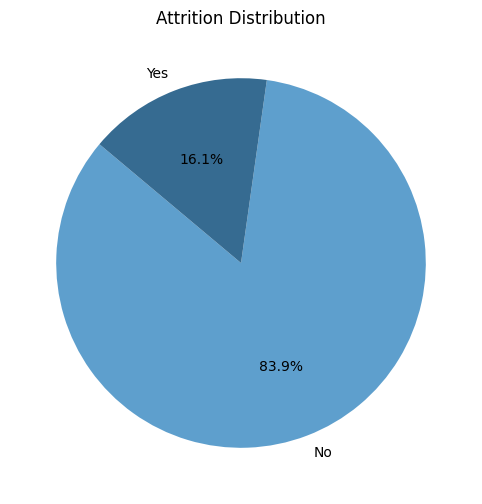

In [18]:


# Aggregate counts of each category in the 'Attrition' column
attrition_counts = df['Attrition'].value_counts()

# Get the 'Blues_d' color palette
colors = sns.color_palette("Blues_d", len(attrition_counts))

# Plot the pie chart
plt.figure(figsize=(8, 6))
plt.pie(attrition_counts, labels=attrition_counts.index, autopct='%1.1f%%', colors=colors, startangle=140)
plt.title('Attrition Distribution')
plt.show()

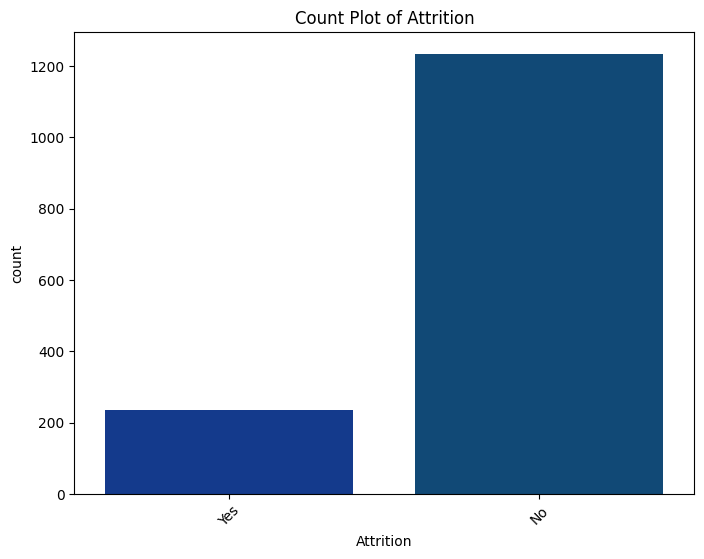

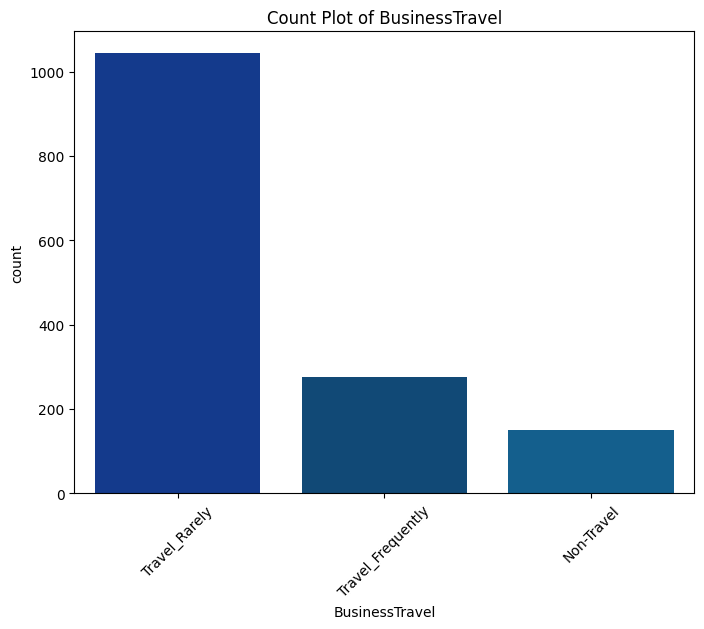

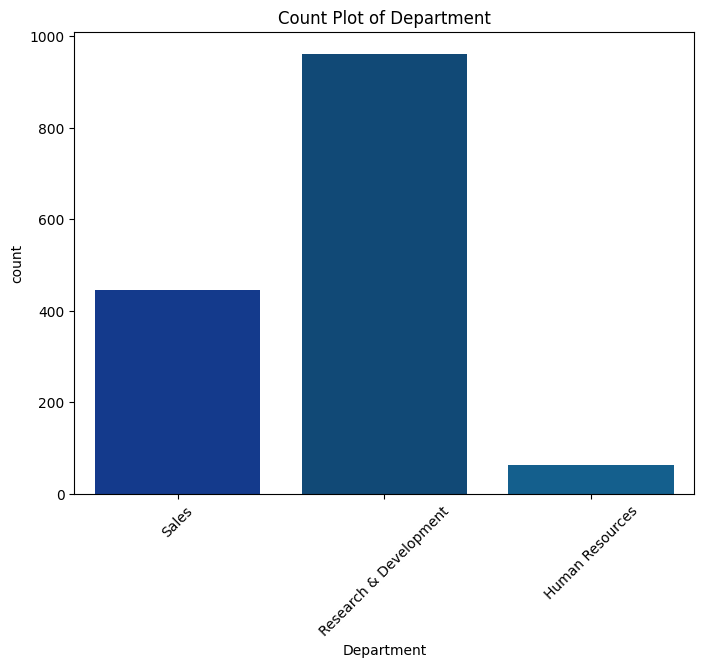

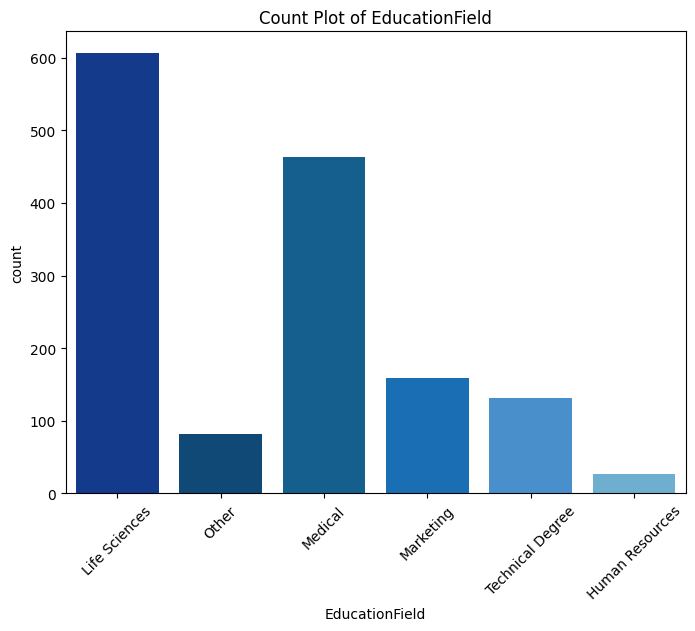

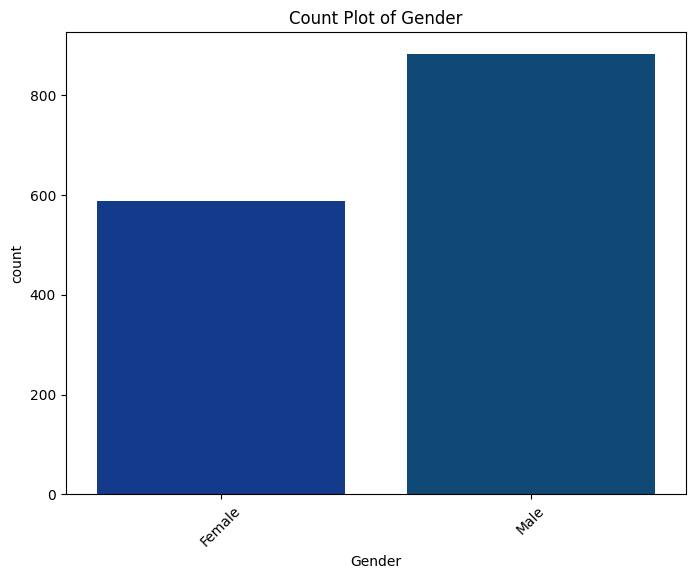

...

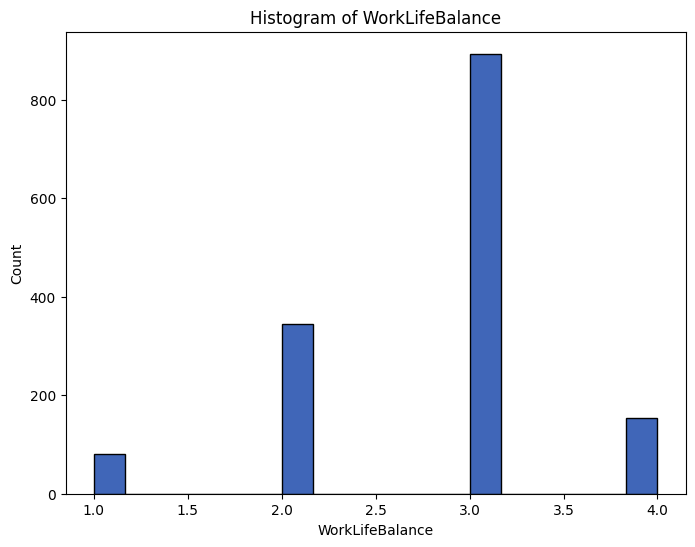

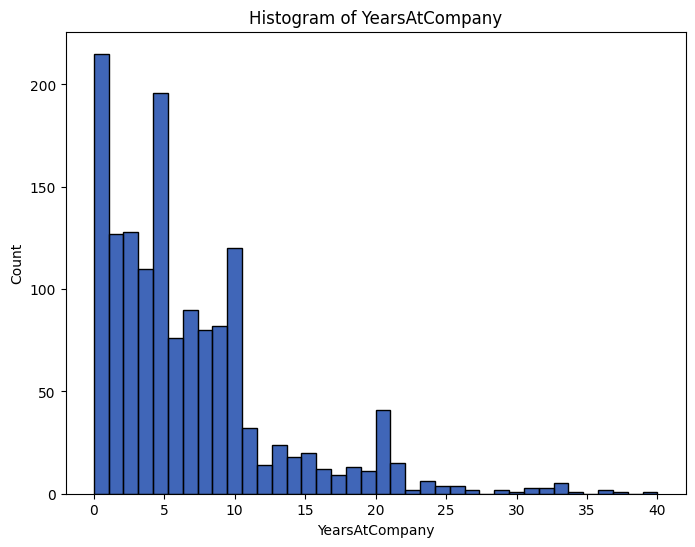

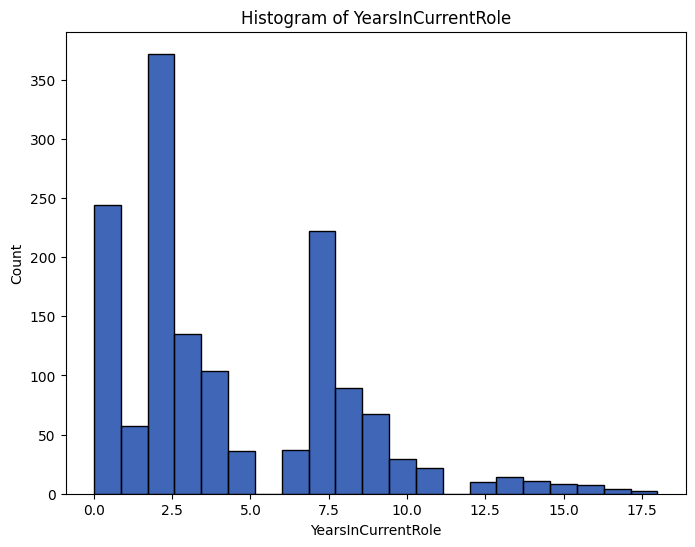

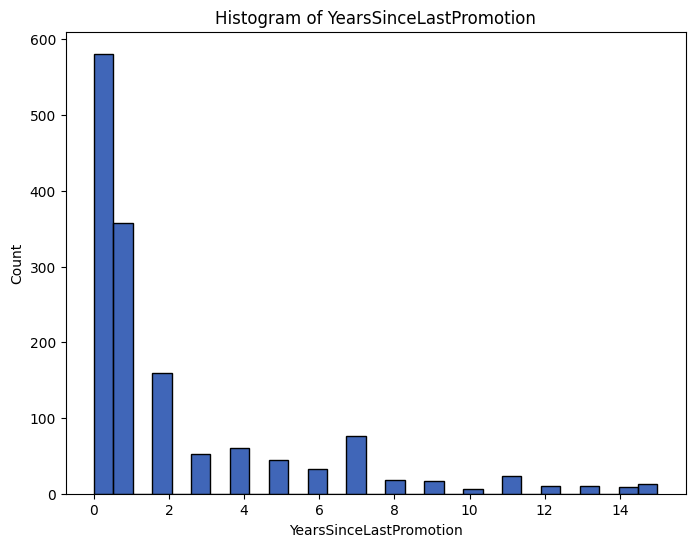

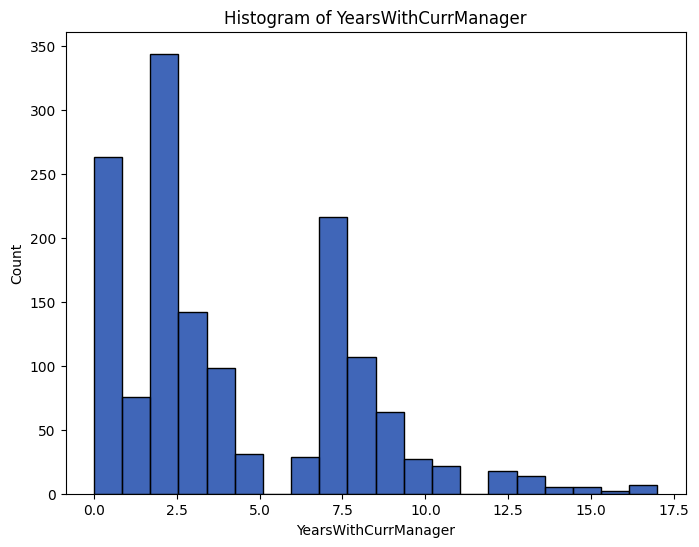

In [19]:
# Define the IBM Blues color palette
ibm_blues = ["#0033A0", "#004B87", "#0064A1", "#0072CE", "#3391E1", "#5EB4E0"]

# Plot count plots for categorical columns
categorical_columns = df.select_dtypes(include=[object]).columns

for col in categorical_columns:
    plt.figure(figsize=(8, 6))
    sns.countplot(data=df, x=col, palette=ibm_blues)
    plt.title(f'Count Plot of {col}')
    plt.xticks(rotation=45)
    plt.show()

# Plot histograms for numerical columns
numerical_columns = df.select_dtypes(include=[int, float]).columns

for col in numerical_columns:
    plt.figure(figsize=(8, 6))
    sns.histplot(df[col], kde=False, color=ibm_blues[0])  # Use the first color in the palette for histograms
    plt.title(f'Histogram of {col}')
    plt.xlabel(col)
    plt.ylabel('Count')
    plt.show()

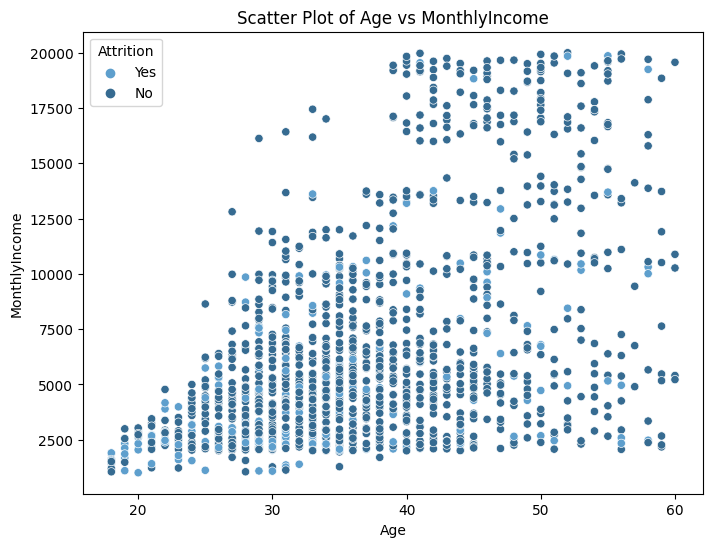

In [20]:
# Scatter Plot
# Get the 'Blues_d' color palette
palette = sns.color_palette("Blues_d", n_colors=len(df['Attrition'].unique()))

# Scatter Plot
plt.figure(figsize=(8, 6))
sns.scatterplot(data=df, x='Age', y='MonthlyIncome', hue='Attrition', palette=palette)
plt.title('Scatter Plot of Age vs MonthlyIncome')
plt.show()

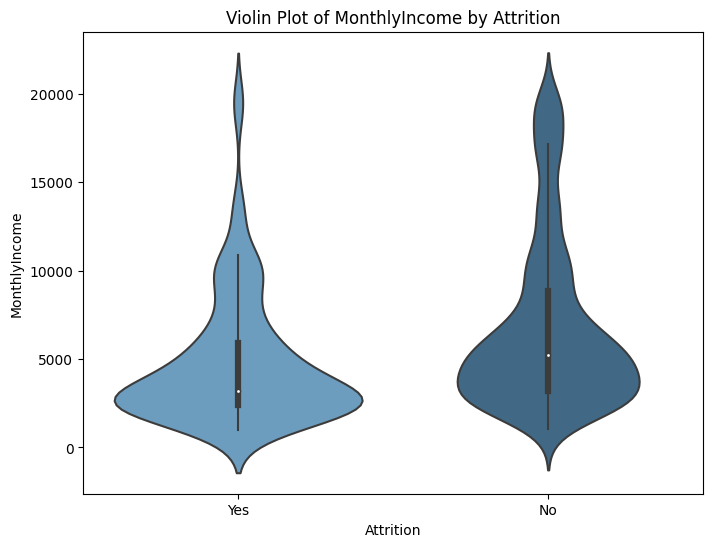

In [21]:
# Violin Plot
plt.figure(figsize=(8, 6))
sns.violinplot(data=df, x='Attrition', y='MonthlyIncome', palette=palette)
plt.title('Violin Plot of MonthlyIncome by Attrition')
plt.show()

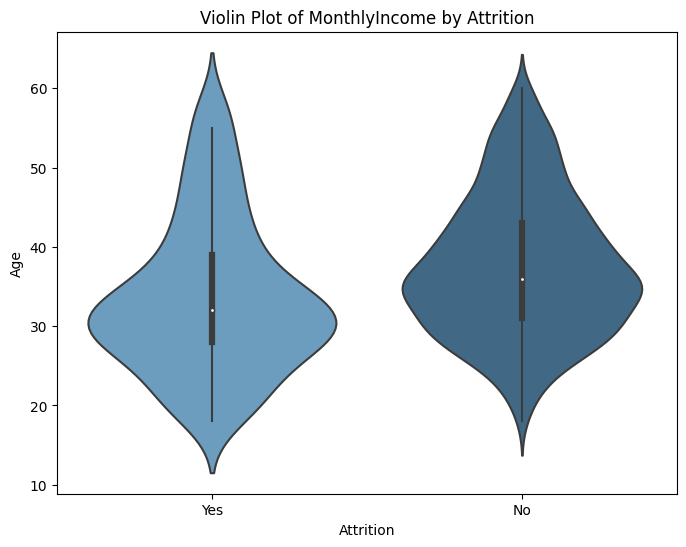

In [22]:
# Violin Plot
plt.figure(figsize=(8, 6))
sns.violinplot(data=df, x='Attrition', y='Age', palette=palette)
plt.title('Violin Plot of MonthlyIncome by Attrition')
plt.show()

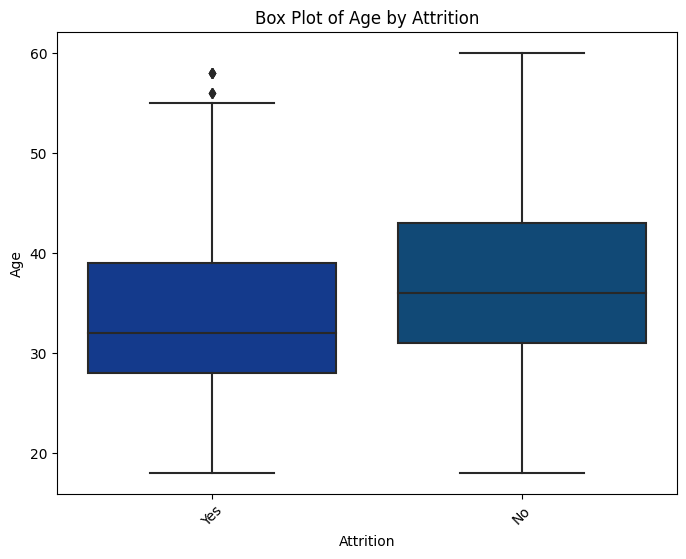

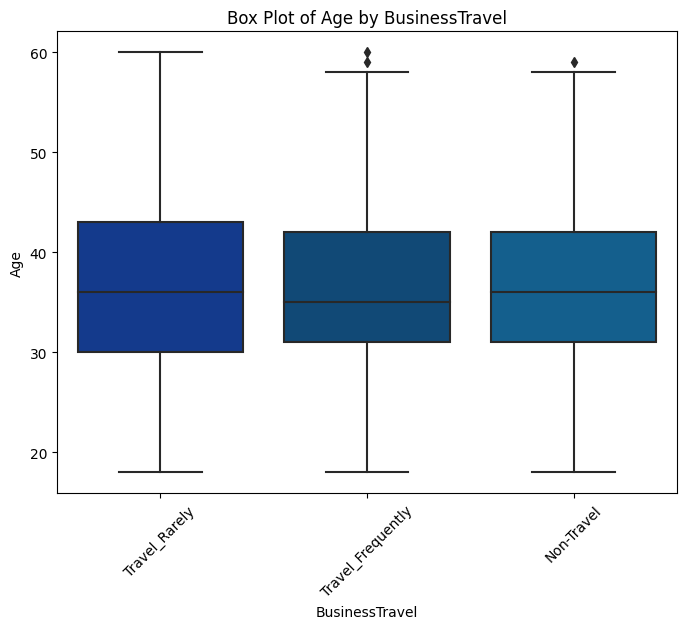

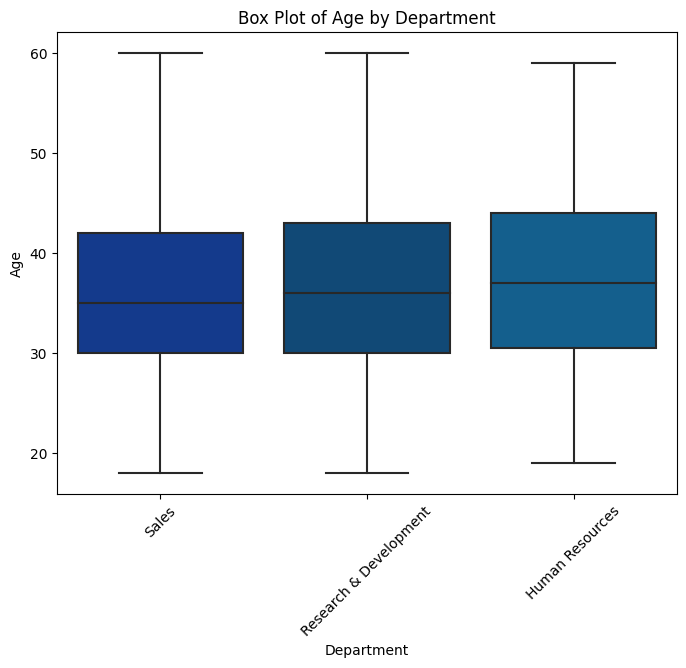

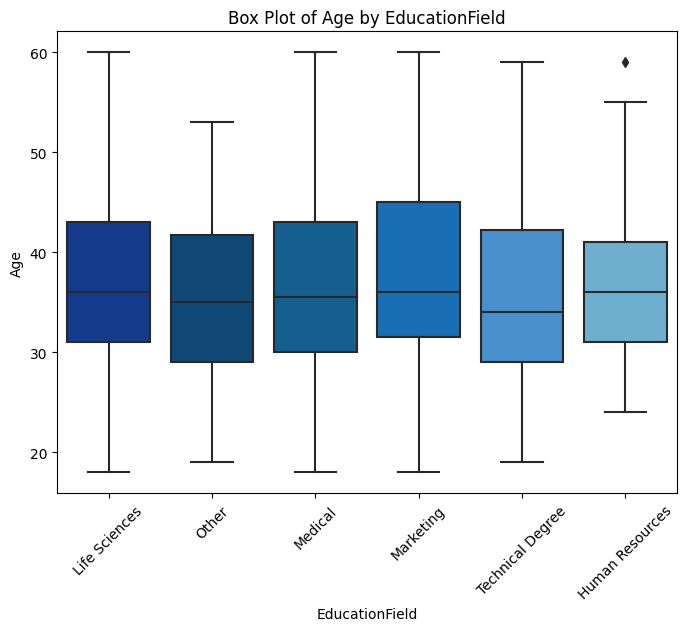

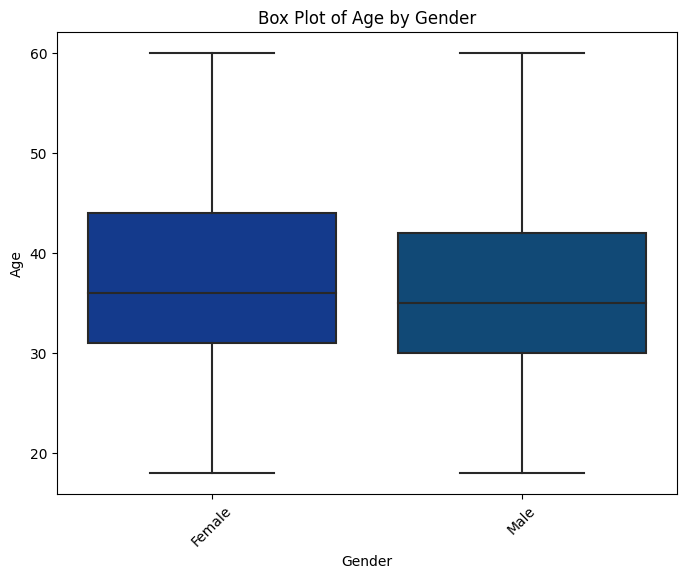

...

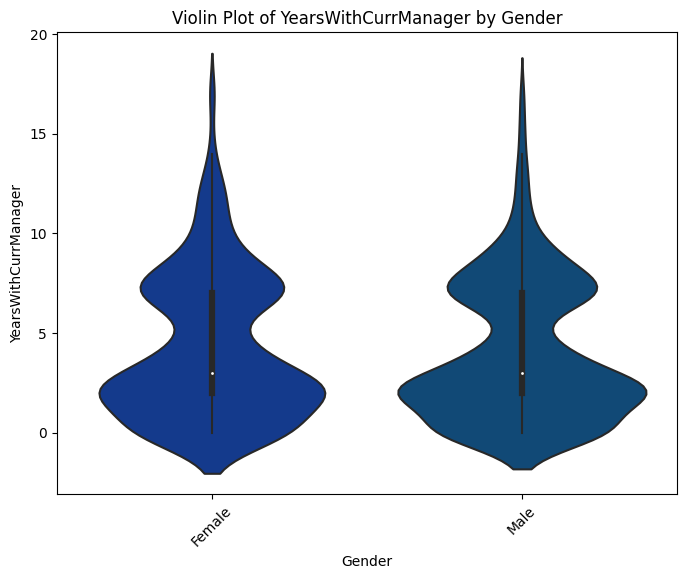

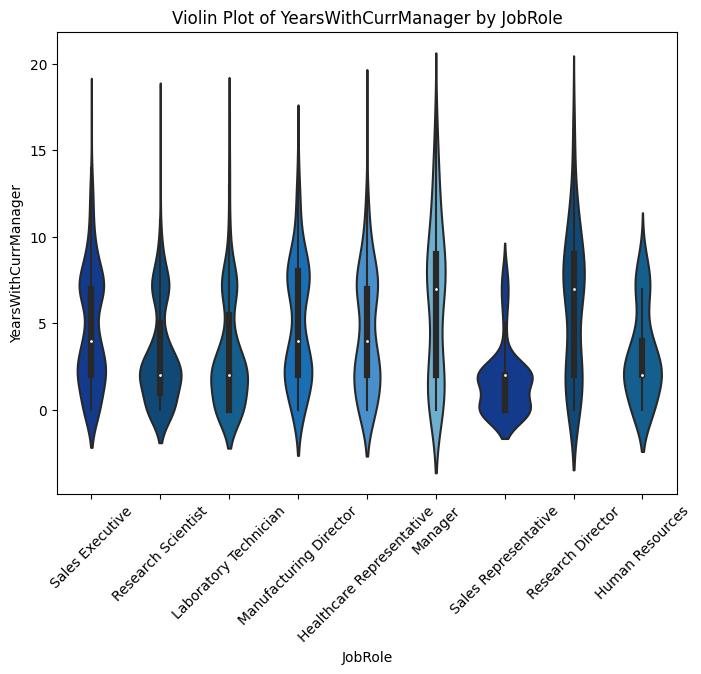

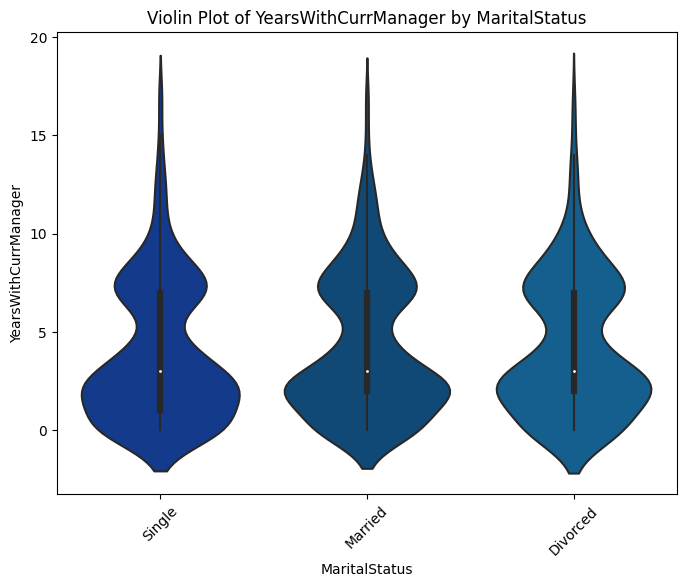

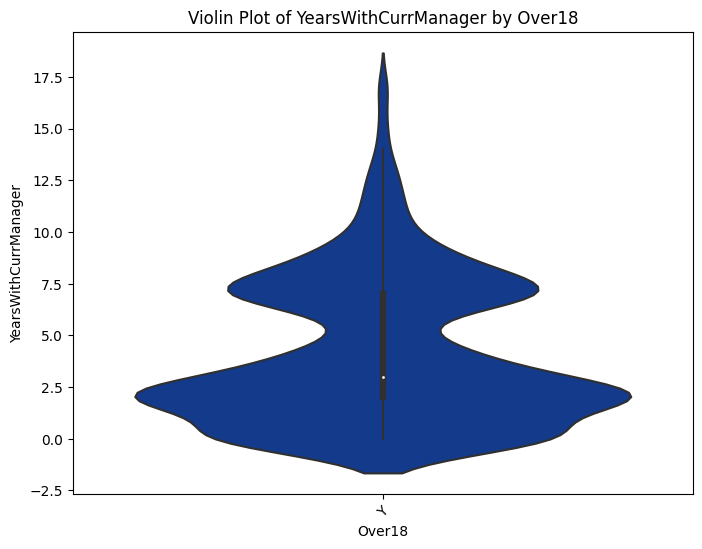

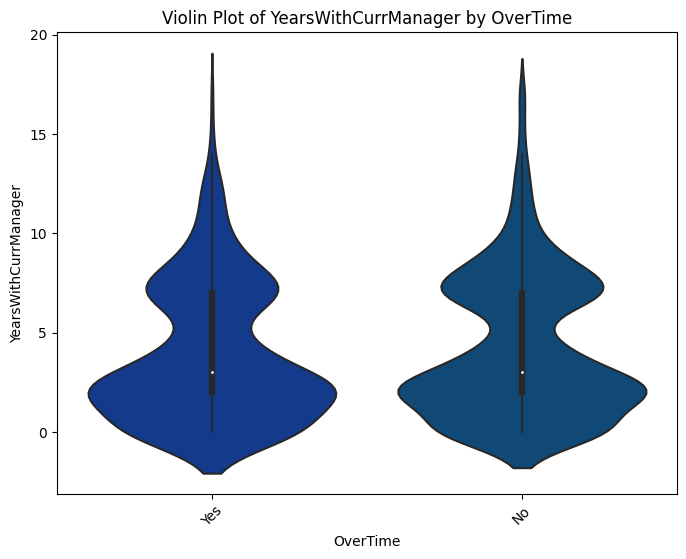

In [23]:

# Define the IBM Blues color palette
ibm_blues = ["#0033A0", "#004B87", "#0064A1", "#0072CE", "#3391E1", "#5EB4E0"]

# Box Plots for numerical columns against categorical columns
categorical_columns = df.select_dtypes(include=[object]).columns
numerical_columns = df.select_dtypes(include=[int, float]).columns

for num_col in numerical_columns:
    for cat_col in categorical_columns:
        plt.figure(figsize=(8, 6))
        ax = sns.boxplot(data=df, x=cat_col, y=num_col, palette=ibm_blues)
        plt.title(f'Box Plot of {num_col} by {cat_col}')
        plt.xticks(rotation=45)

        # Adding data labels
        for i, patch in enumerate(ax.artists):
            color = ibm_blues[i % len(ibm_blues)]
            patch.set_edgecolor(color)
            patch.set_linewidth(1.5)
            plt.text(patch.get_x() + patch.get_width() / 2., patch.get_y() + patch.get_height(), 
                     f'{patch.get_height():.2f}', ha='center', va='bottom', color=color)

        plt.show()

# Violin Plots for numerical columns against categorical columns
for num_col in numerical_columns:
    for cat_col in categorical_columns:
        plt.figure(figsize=(8, 6))
        ax = sns.violinplot(data=df, x=cat_col, y=num_col, palette=ibm_blues)
        plt.title(f'Violin Plot of {num_col} by {cat_col}')
        plt.xticks(rotation=45)

        # Adding data labels
        for i, patch in enumerate(ax.patches):
            color = ibm_blues[i % len(ibm_blues)]
            patch.set_edgecolor(color)
            patch.set_linewidth(1.5)
            plt.text(patch.get_x() + patch.get_width() / 2., patch.get_y() + patch.get_height(), 
                     f'{patch.get_height():.2f}', ha='center', va='bottom', color=color)

        plt.show()

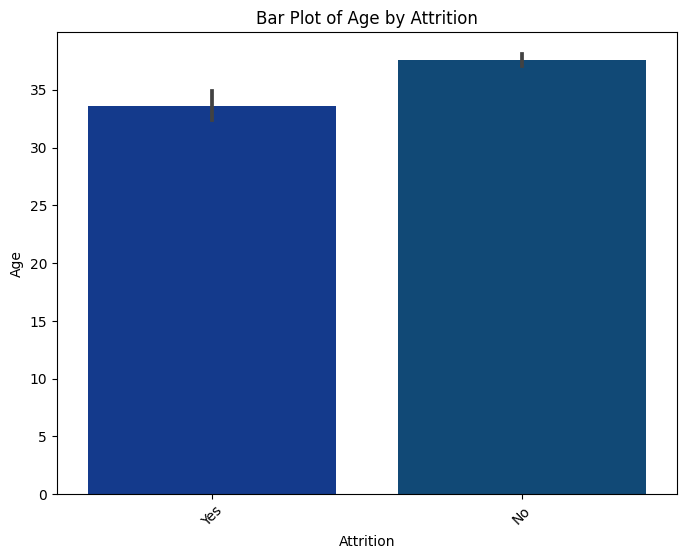

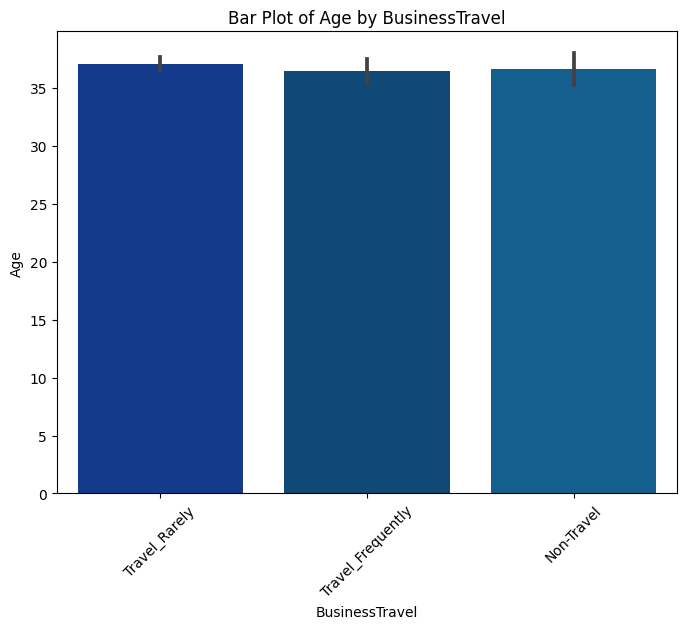

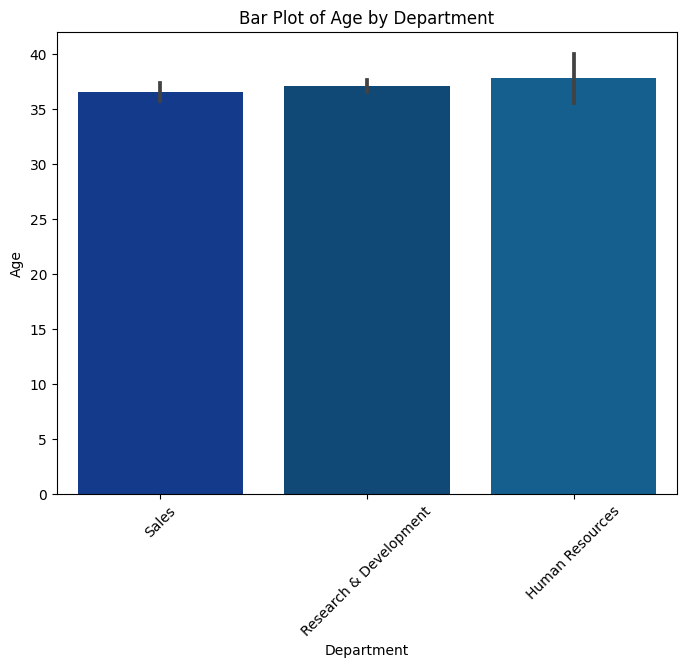

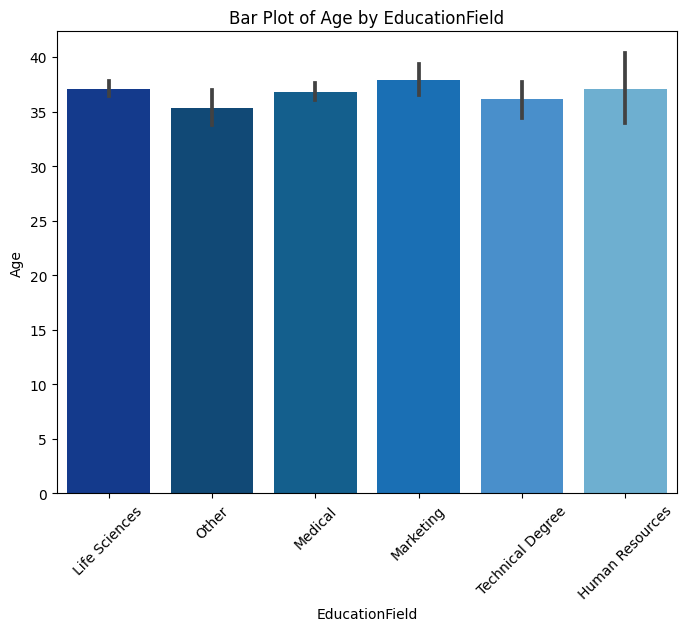

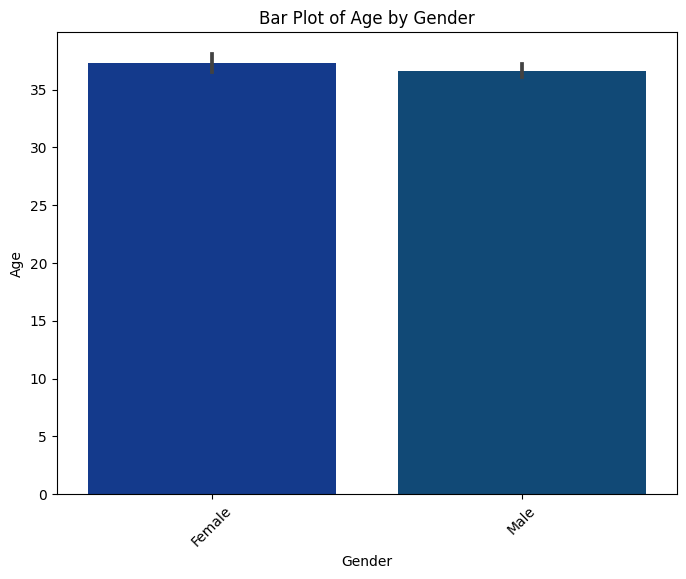

...

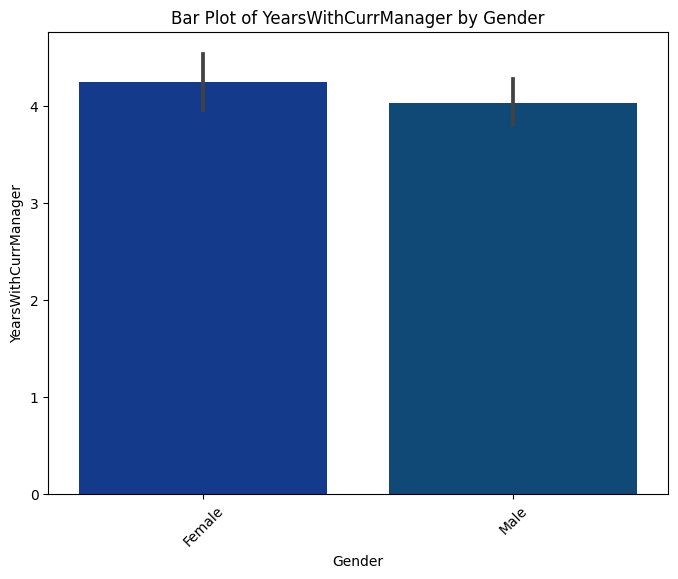

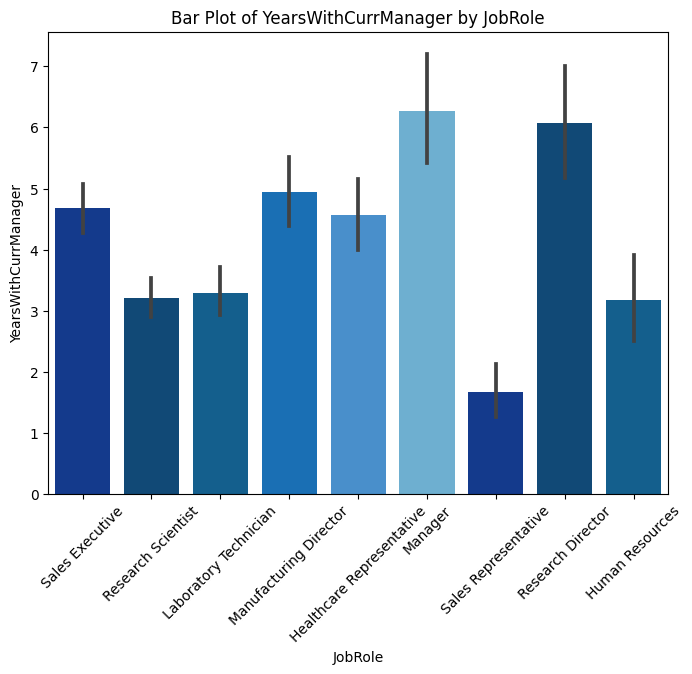

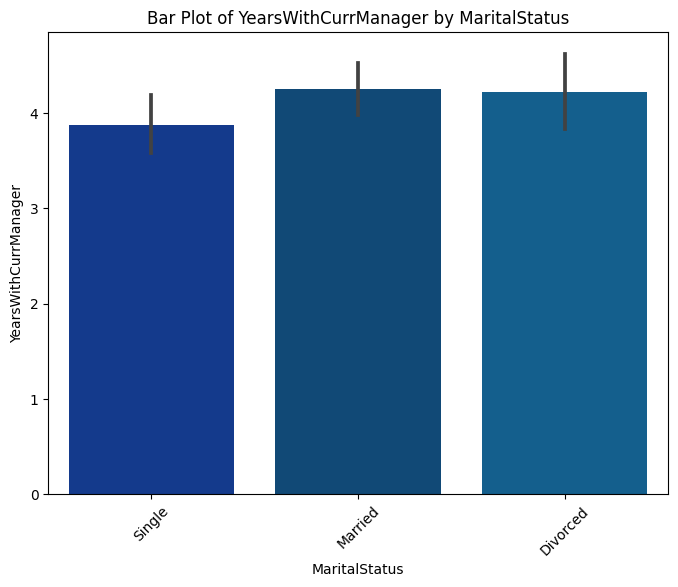

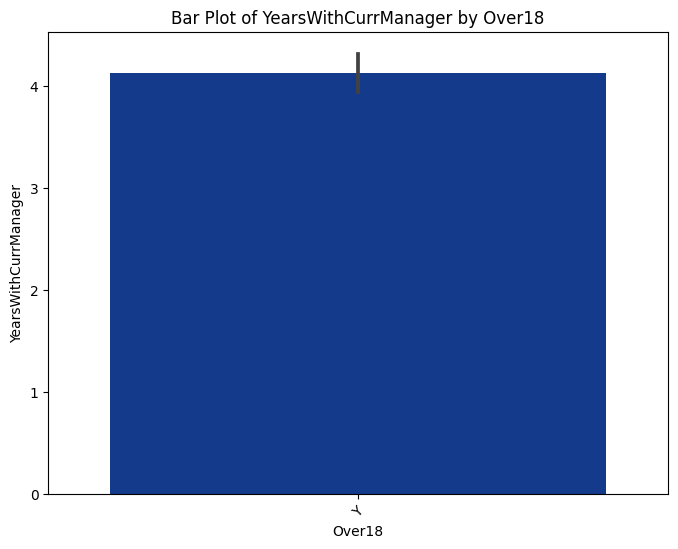

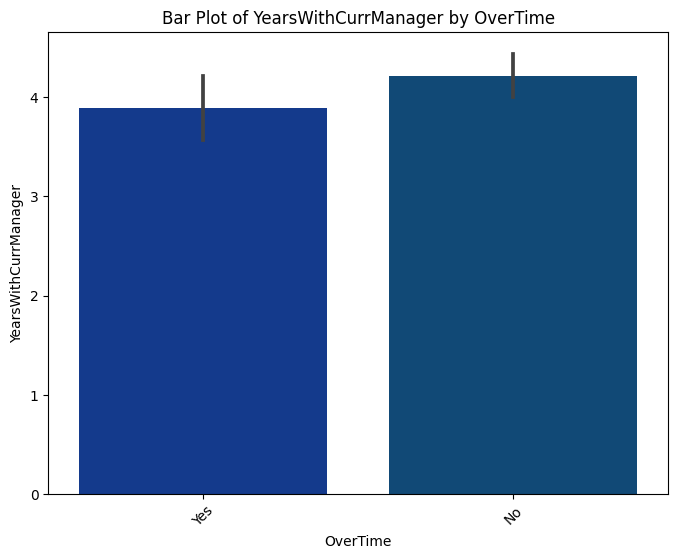

In [24]:
# Define the IBM Blues color palette
ibm_blues = ["#0033A0", "#004B87", "#0064A1", "#0072CE", "#3391E1", "#5EB4E0"]

# Bar Plots for numerical columns against categorical columns
categorical_columns = df.select_dtypes(include=[object]).columns
numerical_columns = df.select_dtypes(include=[int, float]).columns

for num_col in numerical_columns:
    for cat_col in categorical_columns:
        plt.figure(figsize=(8, 6))
        ax = sns.barplot(data=df, x=cat_col, y=num_col, palette=ibm_blues)
        plt.title(f'Bar Plot of {num_col} by {cat_col}')
        plt.xticks(rotation=45)

        
        plt.show()


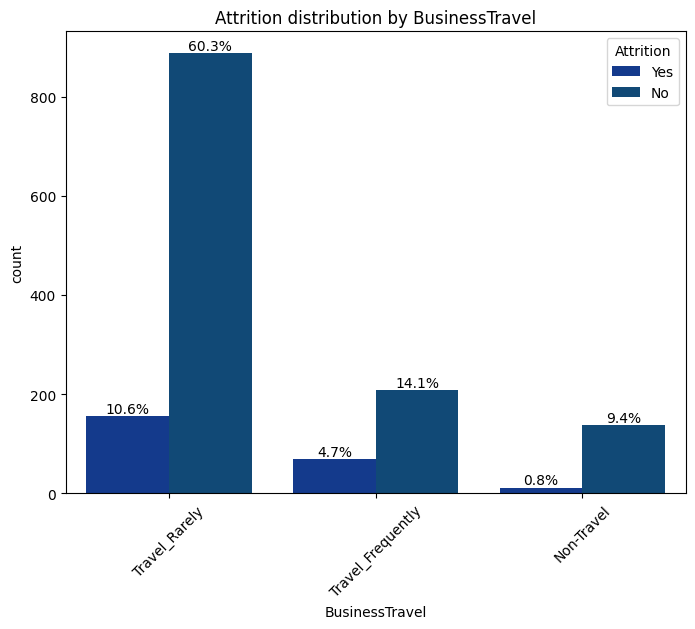

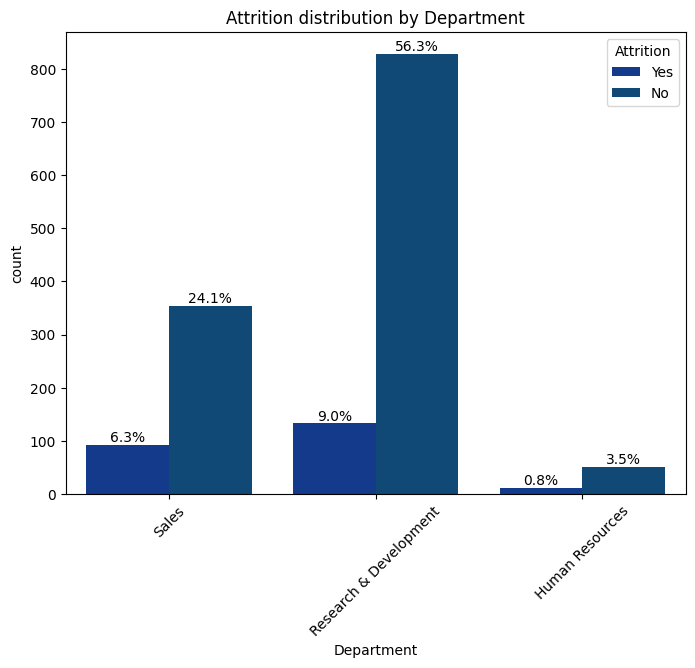

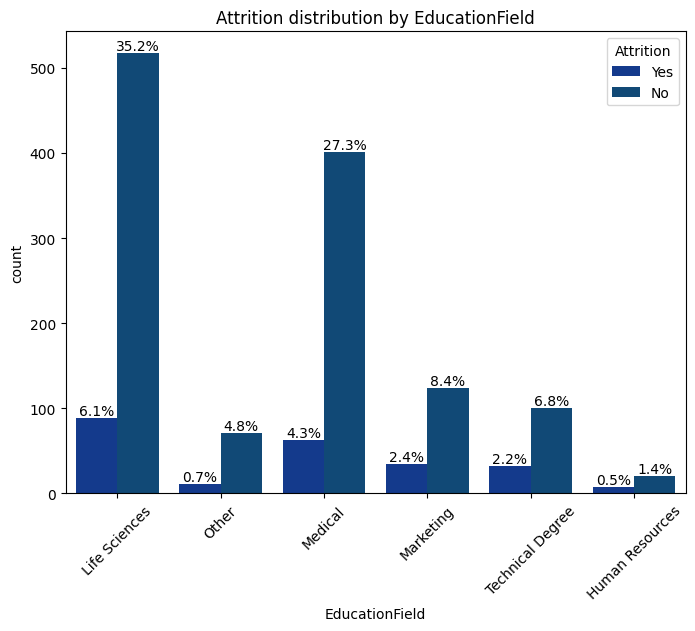

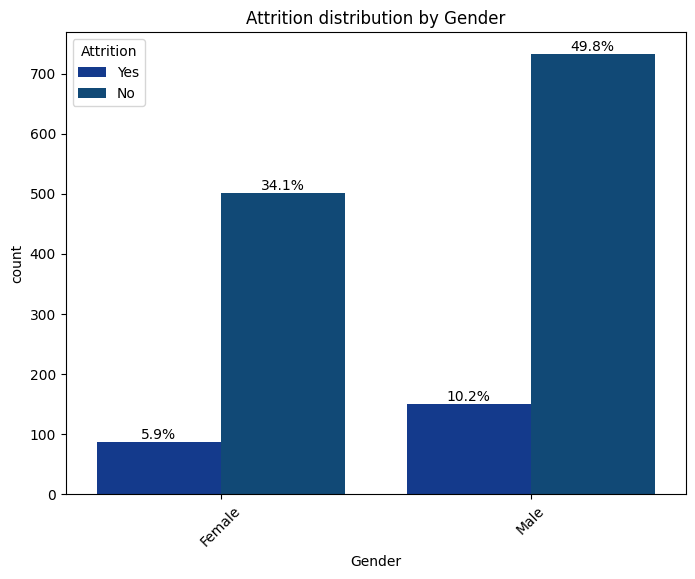

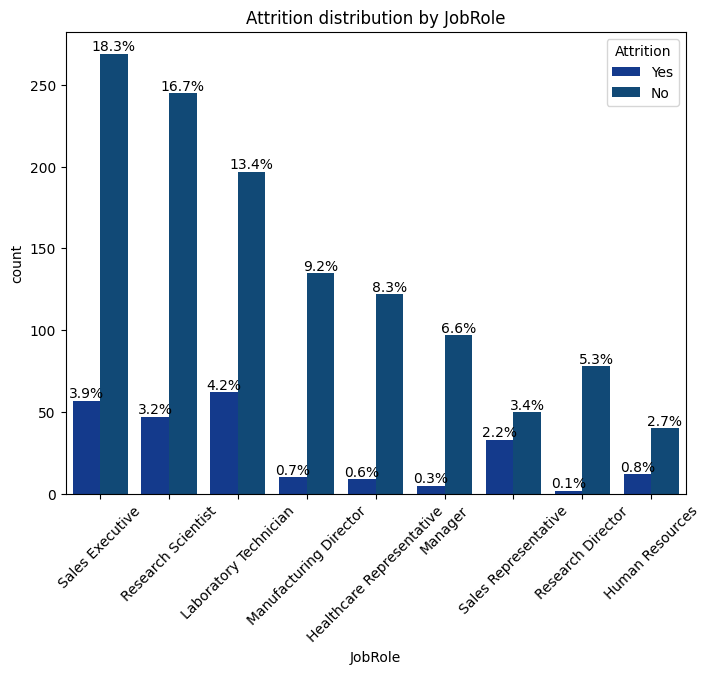

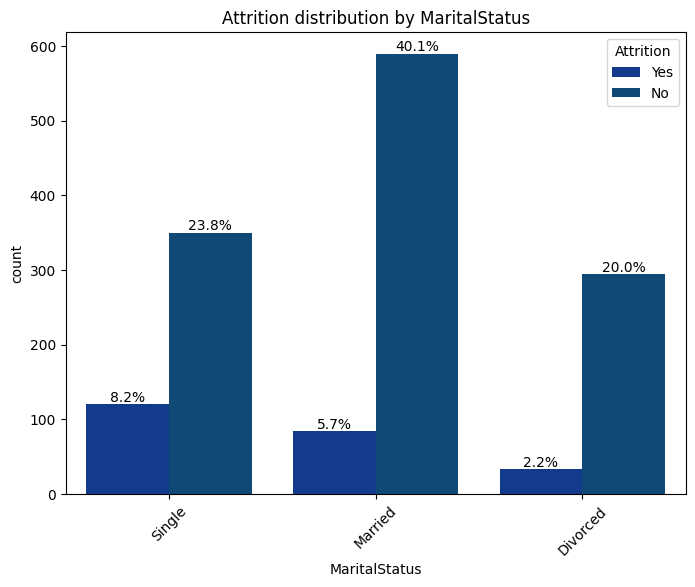

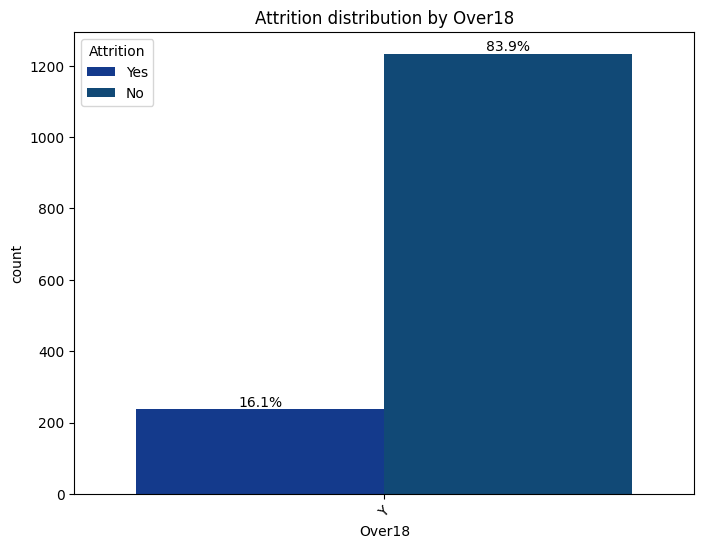

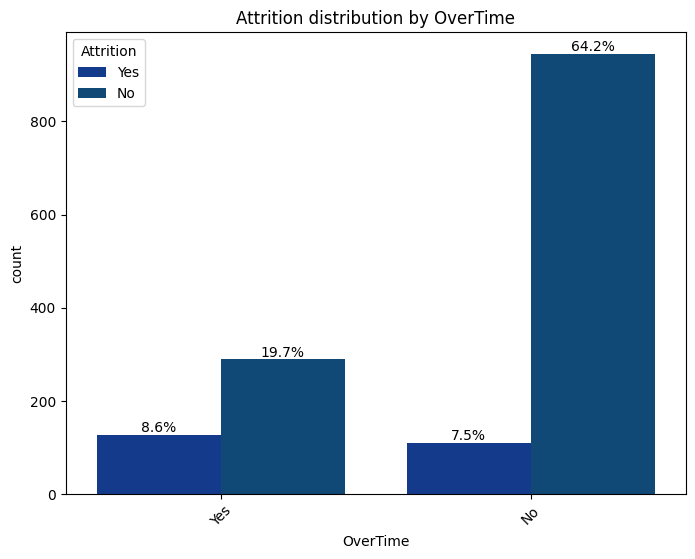

In [25]:
# Define the IBM Blues color palette
ibm_blues = ["#0033A0", "#004B87", "#0064A1", "#0072CE", "#3391E1", "#5EB4E0"]

# Get categorical columns excluding 'Attrition'
cat_cols = df.select_dtypes(include=[object]).columns
cat_cols = cat_cols[cat_cols != 'Attrition']

for col in cat_cols:
    plt.figure(figsize=(8, 6))
    ax = sns.countplot(x=col, hue='Attrition', data=df, palette=ibm_blues)
    plt.title("Attrition distribution by " + col)
    
    total_height = len(df['Attrition'])
    for p in ax.patches:
        percentage = '{:.1f}%'.format(100 * p.get_height() / total_height)
        x = p.get_x() + p.get_width() / 2
        y = p.get_height()
        ax.annotate(percentage, (x, y), ha='center', va='bottom', fontsize=10, color='black')
        
    plt.xticks(rotation=45)  # Rotate x-axis labels if needed
    plt.show()

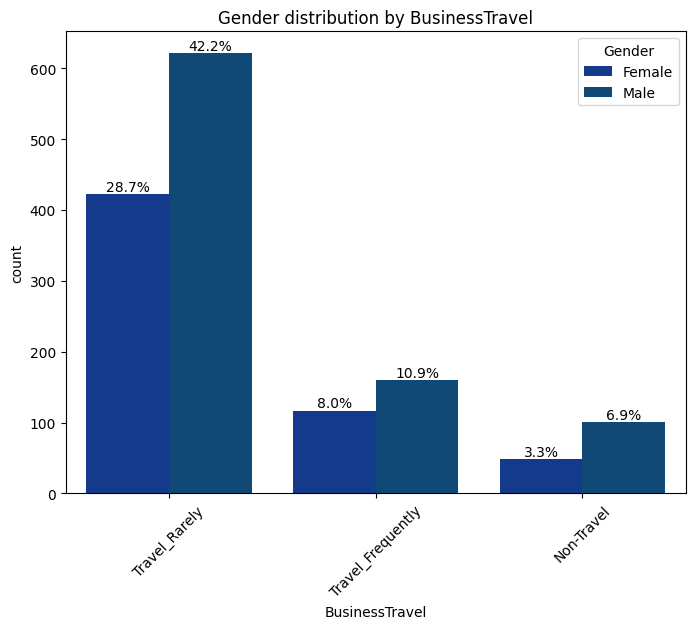

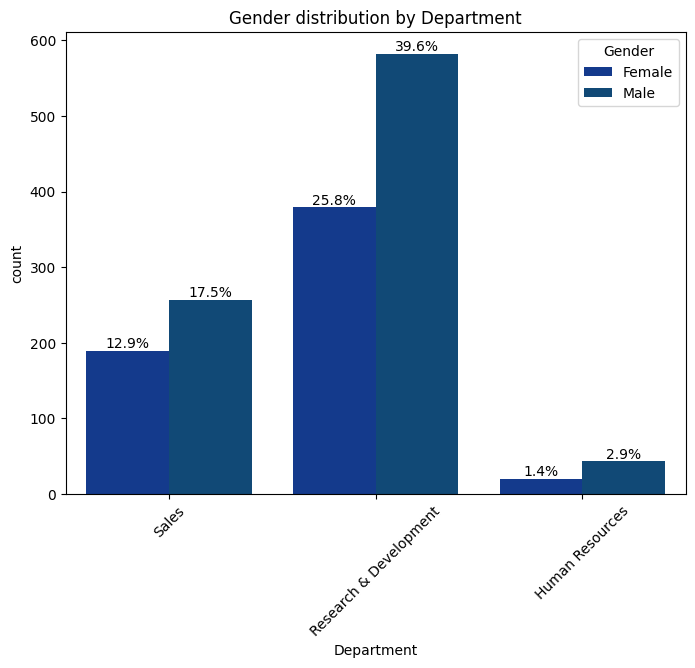

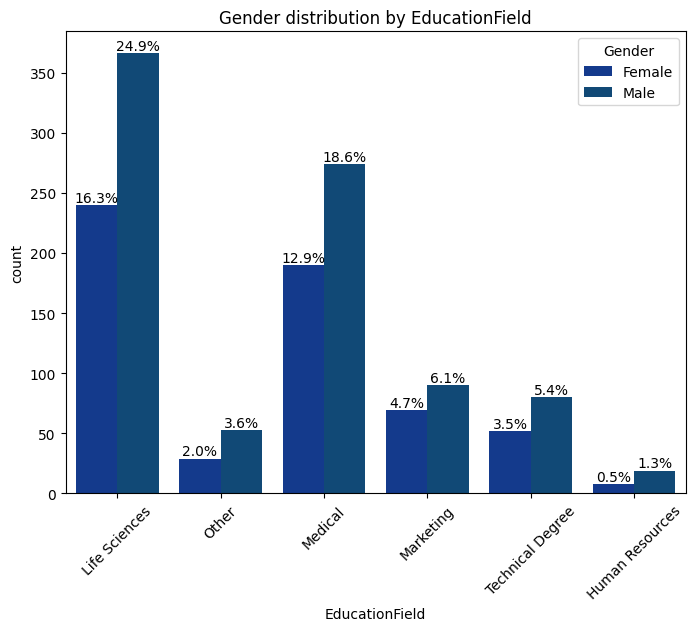

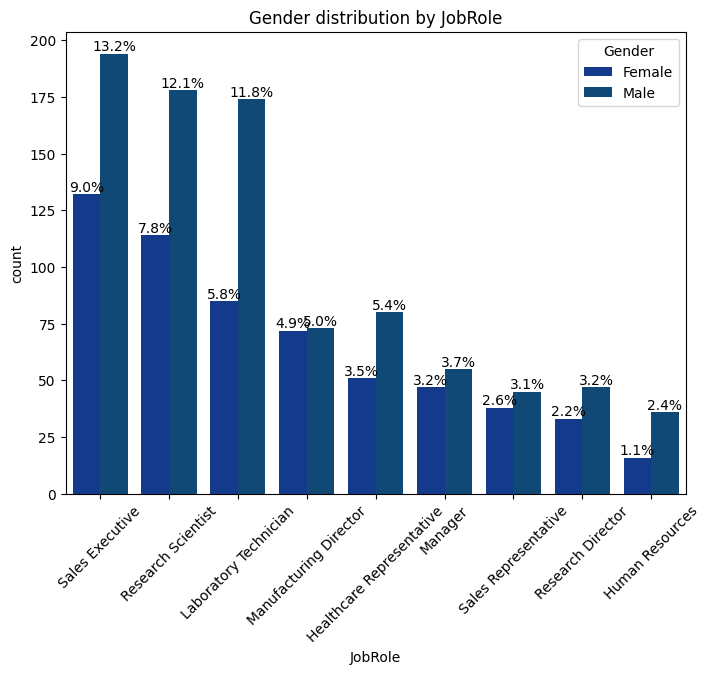

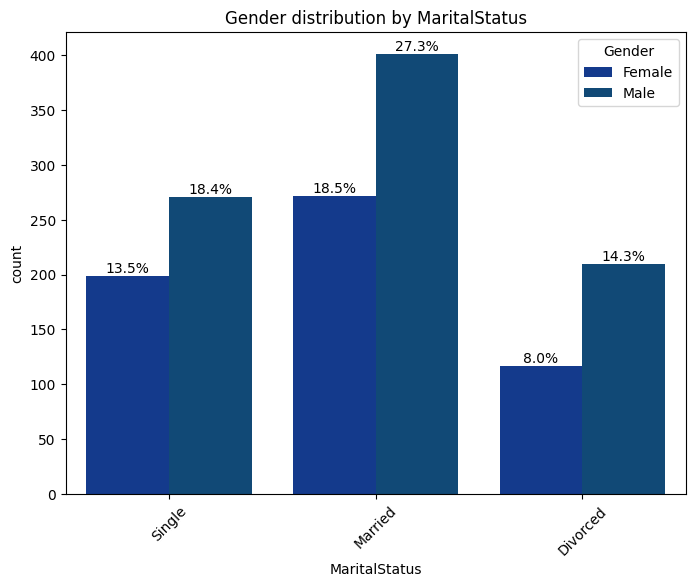

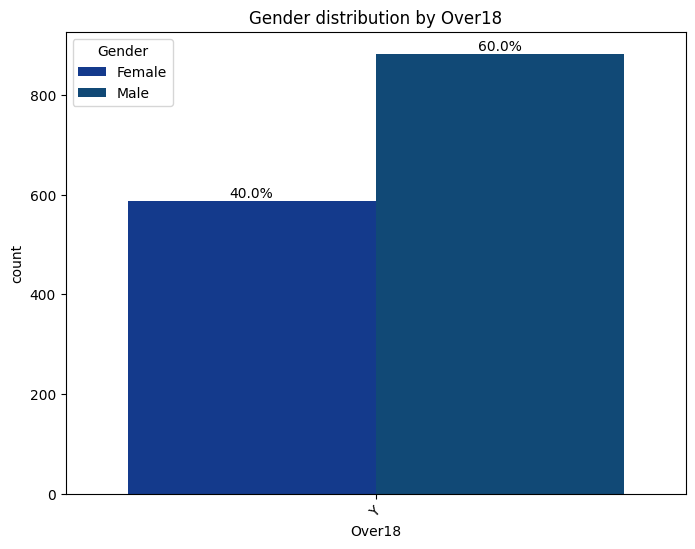

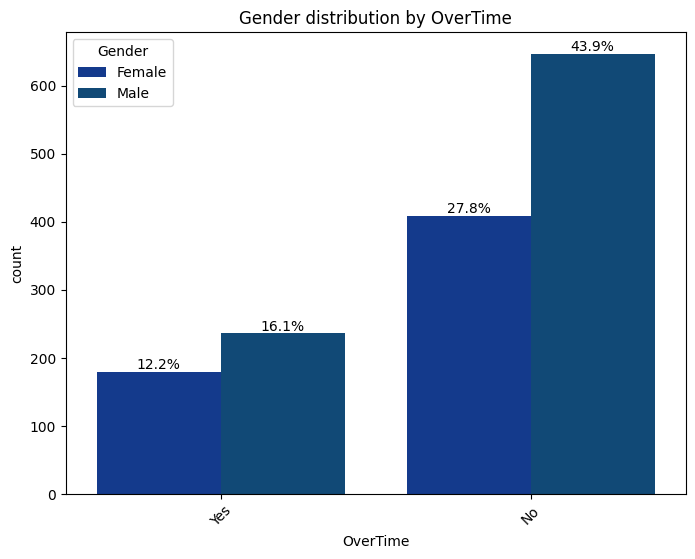

In [26]:
# Define the IBM Blues color palette
ibm_blues = ["#0033A0", "#004B87", "#0064A1", "#0072CE", "#3391E1", "#5EB4E0"]

# Get categorical columns excluding 'Attrition' and 'Gender'
cat_cols = df.select_dtypes(include=[object]).columns
cat_cols = cat_cols[~cat_cols.isin(['Attrition', 'Gender'])]

for col in cat_cols:
    plt.figure(figsize=(8, 6))
    ax = sns.countplot(x=col, hue='Gender', data=df, palette=ibm_blues)
    plt.title("Gender distribution by " + col)
    
    total_height = len(df['Gender'])
    for p in ax.patches:
        percentage = '{:.1f}%'.format(100 * p.get_height() / total_height)
        x = p.get_x() + p.get_width() / 2
        y = p.get_height()
        ax.annotate(percentage, (x, y), ha='center', va='bottom', fontsize=10, color='black')
        
    plt.xticks(rotation=45)  # Rotate x-axis labels if needed
    plt.show()

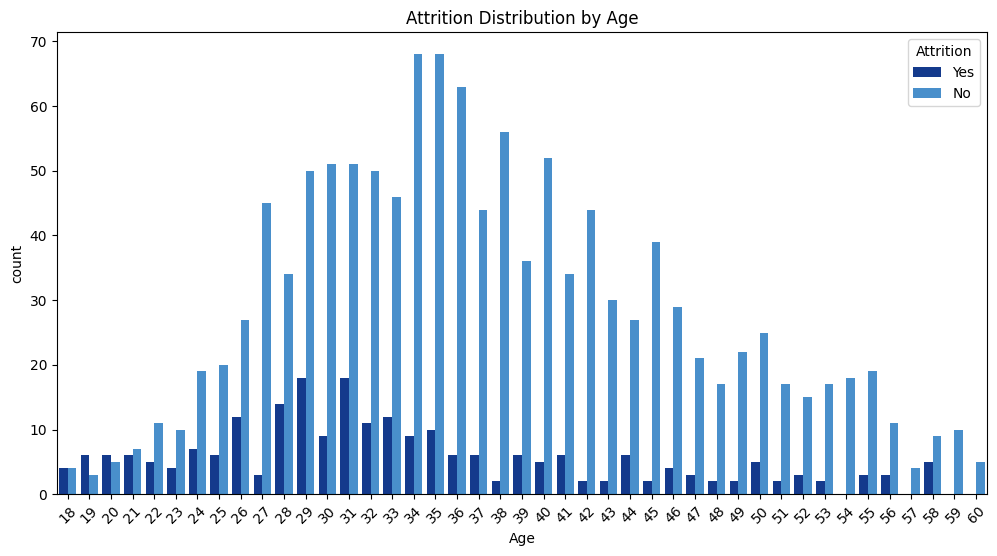

In [27]:
# Define the IBM Blues color palette
ibm_blues = ["#0033A0","#3391E1", "#5EB4E0"]

# Plot count plot
plt.figure(figsize=(12, 6))
ax = sns.countplot(x="Age", hue='Attrition', data=df, palette=ibm_blues)
plt.title("Attrition Distribution by Age")

# Compute total counts for each age
total_counts = df.groupby('Age')['Attrition'].value_counts().unstack(fill_value=0)

# Annotate bars with percentage of Attrition distribution
for p in ax.patches:
    height = p.get_height()
    x = p.get_x() + p.get_width() / 2
    width = p.get_width()
    age = int(x // width)  # Determine age category
    attrition_status = p.get_label()  # Determine Attrition status
    if age in total_counts.index and attrition_status in total_counts.columns:
        percentage = '{:.1f}%'.format(100 * total_counts.loc[age, attrition_status] / total_counts.loc[age].sum())
        ax.annotate(percentage, (x, height), ha='center', va='bottom', fontsize=10, color='black')

plt.xticks(rotation=45)  # Rotate x-axis labels if needed
plt.show()

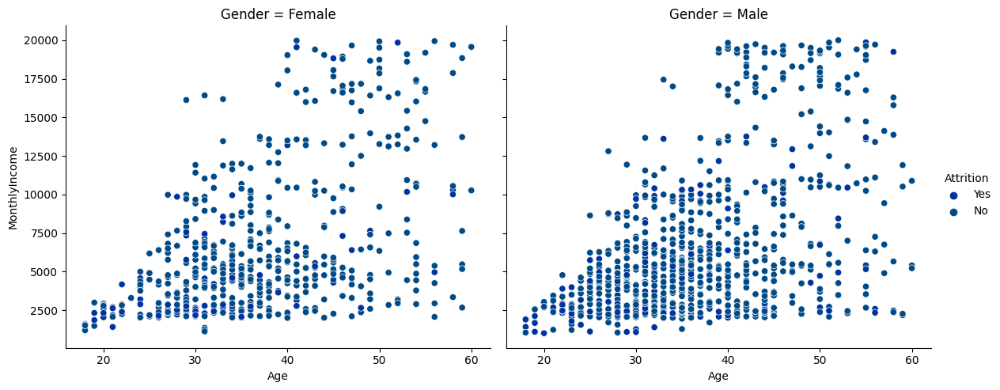

In [28]:
# Define the IBM Blues color palette
ibm_blues = ["#0033A0", "#004B87", "#0064A1", "#0072CE", "#3391E1", "#5EB4E0"]

# Create the scatter plot with faceting
g = sns.relplot(
    data=df,
    x='Age',
    y='MonthlyIncome',
    hue='Attrition',
    col='Gender',
    kind='scatter',
    palette=ibm_blues,
    height=5,  # Adjust height for each facet
    aspect=1.2  # Adjust aspect ratio
)

# Set titles for each facet
for ax in g.axes.flat:
    ax.set_title(ax.get_title().replace('Gender=', 'Gender: '))

plt.show()

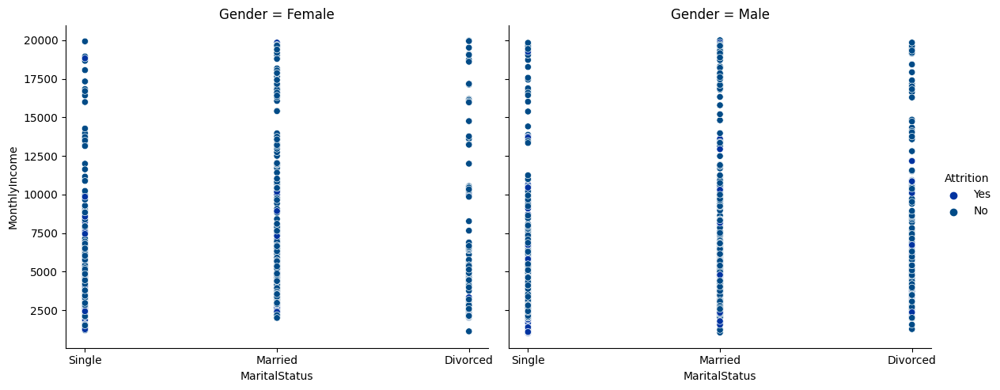

In [29]:
# Define the IBM Blues color palette
ibm_blues = ["#0033A0", "#004B87", "#0064A1", "#0072CE", "#3391E1", "#5EB4E0"]

# Create the scatter plot with faceting
g = sns.relplot(
    data=df,
    x='MaritalStatus',
    y='MonthlyIncome',
    hue='Attrition',
    col='Gender',
    kind='scatter',
    palette=ibm_blues,
    height=5,  # Adjust height for each facet
    aspect=1.2  # Adjust aspect ratio
)

# Set titles for each facet
for ax in g.axes.flat:
    ax.set_title(ax.get_title().replace('Gender=', 'Gender: '))

# Adjust x-axis labels if needed
for ax in g.axes.flat:
    ax.set_xticks(range(len(df['MaritalStatus'].unique())))
    ax.set_xticklabels(df['MaritalStatus'].unique())

plt.show()

<Axes: xlabel='Department', ylabel='MonthlyIncome'>

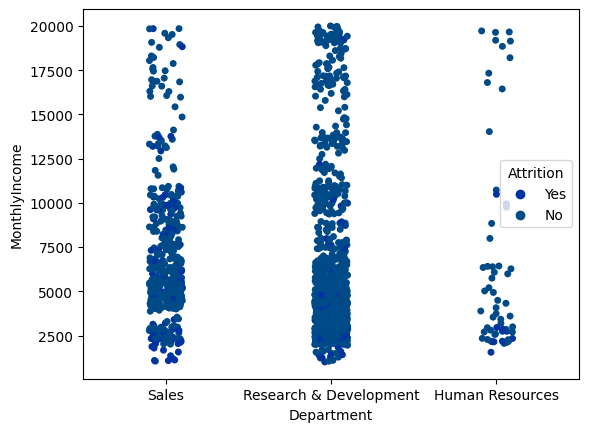

In [30]:
sns.stripplot(data=df, x='Department', y='MonthlyIncome', hue='Attrition', palette=ibm_blues, jitter=True)


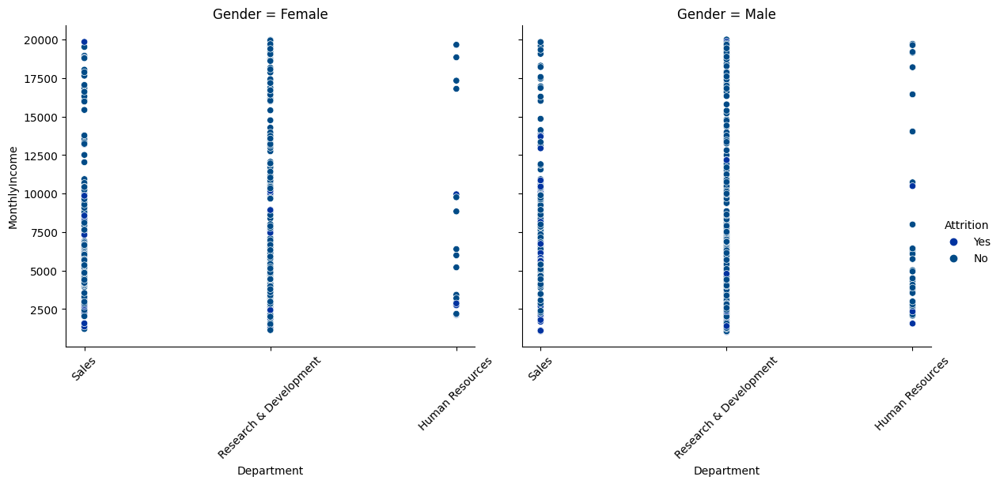

In [31]:
# Define the IBM Blues color palette
ibm_blues = ["#0033A0", "#004B87", "#0064A1", "#0072CE", "#3391E1", "#5EB4E0"]

# Create the scatter plot with faceting
g = sns.relplot(
    data=df,
    x='Department',
    y='MonthlyIncome',
    hue='Attrition',
    col='Gender',
    kind='scatter',
    palette=ibm_blues,
    height=5,  # Adjust height for each facet
    aspect=1.2  # Adjust aspect ratio
)

# Set titles for each facet
for ax in g.axes.flat:
    ax.set_title(ax.get_title().replace('Gender=', 'Gender: '))

# Adjust x-axis labels to show all categories
for ax in g.axes.flat:
    ax.set_xticks(range(len(df['Department'].unique())))
    ax.set_xticklabels(df['Department'].unique(), rotation=45)

plt.show()